In [40]:
APPLICATION_HOME = "/home/akkodis-nizar_el-maghroudi/projetecole"

In [41]:
import yaml
yamlFile = f"{APPLICATION_HOME}/conf/application.yaml"
with open(yamlFile, "r") as f:
    cfg = yaml.safe_load(f)

In [42]:
import datetime as dt

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [43]:
import pandas as pd 
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline 
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly import tools
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)


import gc
from datetime import datetime 
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.metrics import roc_auc_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn import svm
import lightgbm as lgb
from lightgbm import LGBMClassifier


## A / Exploring the dataset

#### 1. Lecture des données traités au premier nootebook

In [44]:
csvFile = f"cleanedData.csv"

encodage = "UTF-8"#ISO-8859-1
sep = ","

dataset = pd.read_csv(csvFile, sep=",", encoding=encodage)

In [45]:
dataset.columns

Index(['dates', 'id', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9',
       'V10', 'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19',
       'V20', 'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount',
       'Class'],
      dtype='object')

In [46]:
dataset["dates"]=pd.to_datetime(dataset["dates"], format="%Y-%m-%d %H:%M:%S")
dataset = dataset.sort_values(by=["dates"], ascending=True)

>L’objectif des figures ci-dessous est d’analyser la répartition des fraudes bancaires par mois et par heure, afin de détecter d’éventuels schémas ou anomalies remarquables.

In [47]:
# Assurer le bon format
dataset['dates'] = pd.to_datetime(dataset['dates'])
dataset['FraudLabel'] = dataset['Class'].map({0: 'Not Fraud', 1: 'Fraud'})

# ========= 1. Figure combinée : Fraude vs Non Fraude =========
fig_all = px.histogram(
    dataset,
    x='dates',
    color='FraudLabel',
    nbins=100,
    barmode='overlay',
    title='📊 Distribution temporelle - Transactions Fraude vs Non Fraude',
    labels={'dates': 'Date de transaction'},
    color_discrete_map={'Not Fraud': '#1f77b4', 'Fraud': '#d62728'}
)
fig_all.update_layout(template='plotly_white', xaxis_title='Date', yaxis_title='Nombre de transactions')
fig_all.show()

# ========= 2. Figure Fraude uniquement =========
fraud_df = dataset[dataset['Class'] == 1]
fig_fraud = px.histogram(
    fraud_df,
    x='dates',
    nbins=100,
    title='🔴 Distribution temporelle - Transactions Frauduleuses',
    labels={'dates': 'Date de transaction'},
    color_discrete_sequence=['#d62728']
)
fig_fraud.update_layout(template='plotly_white', xaxis_title='Date', yaxis_title='Nombre de fraudes')
fig_fraud.show()

# ========= 3. Figure Non Fraude uniquement =========
not_fraud_df = dataset[dataset['Class'] == 0]
fig_not_fraud = px.histogram(
    not_fraud_df,
    x='dates',
    nbins=100,
    title='🔵 Distribution temporelle - Transactions Non Frauduleuses',
    labels={'dates': 'Date de transaction'},
    color_discrete_sequence=['#1f77b4']
)
fig_not_fraud.update_layout(template='plotly_white', xaxis_title='Date', yaxis_title='Nombre de transactions normales')
fig_not_fraud.show()


### Nombres d'operations frauduleuses et non frauduleurses par mois 

In [48]:
# 1. Regrouper par mois et classe
dataset['Month'] = dataset['dates'].dt.to_period('M')
monthly_counts = dataset.groupby(['Month', 'Class']).size().unstack(fill_value=0)
monthly_counts.index = monthly_counts.index.to_timestamp()

# 2. Transformation en format long
df_plot = monthly_counts.reset_index().melt(id_vars='Month', value_vars=[0, 1], 
                                            var_name='Class', value_name='Count')

# 3. Affichage avec Plotly
fig = px.bar(
    df_plot,
    x='Month',
    y='Count',
    color='Class',
    barmode='stack',
    color_discrete_map={0: "#1f77b4", 1: "#d62728"},
    labels={"Class": "Classe", "Count": "Nombre de transactions"},
    title="Transactions mensuelles par classe",
    template="plotly_white"
)

fig.update_layout(xaxis_title="Mois", yaxis_title="Nombre de transactions")
fig.show()


In [49]:
# Extraire heure et jour
dataset['Hour'] = dataset['dates'].dt.hour
dataset['Weekday'] = dataset['dates'].dt.day_name()

# Filtrer uniquement les fraudes
fraudes = dataset[dataset['Class'] == 1]

# Regrouper les fraudes par jour de la semaine et heure
heatmap_data = fraudes.groupby(['Weekday', 'Hour']).size().unstack(fill_value=0)

# Réordonner les jours dans l'ordre classique
ordered_days = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
heatmap_data = heatmap_data.reindex(ordered_days)

# Création de la heatmap
fig = px.imshow(
    heatmap_data,
    labels=dict(x="Heure", y="Jour", color="Nombre de fraudes"),
    x=[f"{h}h" for h in heatmap_data.columns],  # format "8h", "13h", etc.
    y=heatmap_data.index,
    color_continuous_scale="Reds",
    title="📊 Heatmap des fraudes par heure et jour de la semaine"
)

# Personnalisation de l'affichage
fig.update_layout(
    template="plotly_white",
    xaxis=dict(tickmode="linear"),
    yaxis=dict(tickfont=dict(size=12)),
    title_font_size=20
)

fig.show()


## Partie Machine Learning

>D'après la matrice de corrélation affichée dans le premier notebook, nous avons identifié les features présentant une forte corrélation avec la variable Class.

In [50]:
target = 'Class'
features = ['V2', 'V11', 'V4', 'V21', 'V9', 'V18', 'V5', 'V1', 'V16', 'V3', 'V7', 'V12', 'V10', 'V14', 'V17']

In [51]:
VALID_SIZE = 0.20 # simple validation using train_test_split
TEST_SIZE = 0.20 # test size using_train_test_split

#CROSS-VALIDATION
NUMBER_KFOLDS = 5 #number of KFolds for cross-validation



RANDOM_STATE = 2018
RFC_METRIC = 'gini'  #metric used for RandomForrestClassifier
NUM_ESTIMATORS = 100 #number of estimators used for RandomForrestClassifier
NO_JOBS = 4 
MAX_ROUNDS = 1000 #lgb iterations
EARLY_STOP = 50 #lgb early stop 
OPT_ROUNDS = 1000  #To be adjusted based on best validation rounds
VERBOSE_EVAL = 50 #Print out metric result

In [52]:
train_df, test_df = train_test_split(dataset, test_size=TEST_SIZE, random_state=RANDOM_STATE, shuffle=True )
train_df, valid_df = train_test_split(dataset, test_size=VALID_SIZE, random_state=RANDOM_STATE, shuffle=True )

> Division de la dataset en données d'entrainement de validation et de test

In [53]:
# Taille totale de l'ensemble de données
dataset_size = len(dataset)

# Définir les tailles
train_size = 0.7  # 70 % pour l'entraînement
valid_size = 0.15  # 15 % pour la validation
test_size = 0.15  # 15 % pour le test

# Diviser l'ensemble de données en train et test
train_df, temp_df = train_test_split(dataset, test_size=(1 - train_size), random_state=RANDOM_STATE, shuffle=True)

# Calculer la taille de l'ensemble de validation par rapport à l'ensemble temporaire
valid_ratio = valid_size / (valid_size + test_size)

# Diviser l'ensemble temporaire en validation et test
valid_df, test_df = train_test_split(temp_df, test_size=(1 - valid_ratio), random_state=RANDOM_STATE, shuffle=True)

# Vérification des tailles
print(f"Taille de l'ensemble d'entraînement : {len(train_df)}")
print(f"Taille de l'ensemble de validation : {len(valid_df)}")
print(f"Taille de l'ensemble de test : {len(test_df)}")

Taille de l'ensemble d'entraînement : 149540
Taille de l'ensemble de validation : 32045
Taille de l'ensemble de test : 32045


>On utilise d'abord la Random Forest car elle ne suppose pas de relation linéaire entre les variables et la cible, ce qui est adapté lorsque les relations sont complexes ou non linéaires, comme c’est le cas ici.

In [54]:
clf = RandomForestClassifier(n_jobs=NO_JOBS, 
                             random_state=RANDOM_STATE,
                             criterion=RFC_METRIC,
                             n_estimators=NUM_ESTIMATORS,
                             verbose=False)

> Entrer les features et la target(Class) au modèle 

In [55]:
clf.fit(train_df[features], train_df[target].values)


RandomForestClassifier(n_jobs=4, random_state=2018, verbose=False)

In [56]:
clf.fit(train_df[features], train_df[target])

preds = clf.predict(valid_df[features])


/tmp/ipykernel_136494/3986122624.py:6: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.



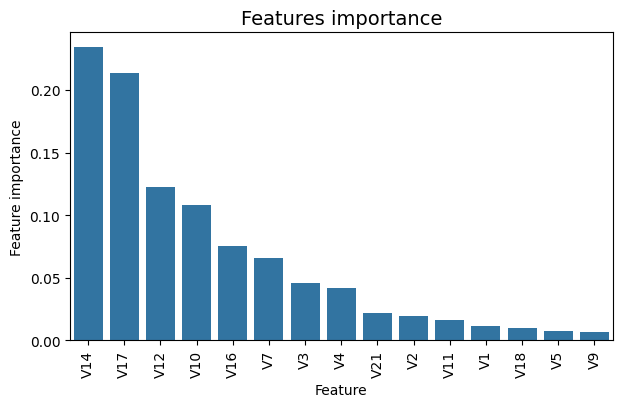

In [57]:
tmp = pd.DataFrame({'Feature': features, 'Feature importance': clf.feature_importances_})
tmp = tmp.sort_values(by='Feature importance',ascending=False)
plt.figure(figsize = (7,4))
plt.title('Features importance',fontsize=14)
s = sns.barplot(x='Feature',y='Feature importance',data=tmp)
s.set_xticklabels(s.get_xticklabels(),rotation=90)
plt.show()   


In [58]:
# Charger le dataset
# dataset = pd.read_csv(...)  # ou toute autre méthode de chargement

# Supposons que 'target' soit la colonne cible
X = dataset[features]
y = dataset[target]  # Cible

# Diviser les données en ensembles d'entraînement, de validation et de test
train_df, temp_df = train_test_split(dataset, test_size=0.3, random_state=42, shuffle=True)
valid_df, test_df = train_test_split(temp_df, test_size=0.5, random_state=42, shuffle=True)

# Séparer les caractéristiques et la cible avec uniquement les colonnes de `features`
X_train = train_df[features]
y_train = train_df[target]

X_valid = valid_df[features]
y_valid = valid_df[target]

X_test = test_df[features]
y_test = test_df[target]


In [59]:
pip install imblearn


[notice] A new release of pip is available: 25.0.1 -> 25.1.1
[notice] To update, run: /home/akkodis-nizar_el-maghroudi/Projet_MCT244/MCT244/rt/python/default/3.11.11/bin/python -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [60]:
pip install --upgrade lightgbm



[notice] A new release of pip is available: 25.0.1 -> 25.1.1
[notice] To update, run: /home/akkodis-nizar_el-maghroudi/Projet_MCT244/MCT244/rt/python/default/3.11.11/bin/python -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [61]:
def corrHeatmap(df, target_col, cols=None, threshold=0.3):
    """
    Affiche une heatmap des corrélations significatives avec une colonne cible.

    :param df: DataFrame pandas
    :param target_col: Nom (str) de la colonne cible pour la corrélation
    :param cols: Liste optionnelle des colonnes à comparer
    :param threshold: Seuil absolu minimum de corrélation à afficher (ex: 0.3)
    :return: Liste des noms de colonnes avec corrélation absolue >= threshold
    """
    import numpy as np
    import matplotlib.pyplot as plt
    import seaborn as sns

    if cols is None:
        cols = df.select_dtypes(include='number').columns.drop(target_col, errors='ignore')

    corr_series = df[cols].corrwith(df[target_col])
    filtered_corr = corr_series[abs(corr_series) >= threshold].sort_values(ascending=False)

    if filtered_corr.empty:
        print(f"Aucune corrélation au-dessus de {threshold}")
        return []

    plt.figure(figsize=(6, len(filtered_corr) * 0.4))
    sns.heatmap(filtered_corr.to_frame(name=f"Corr. avec {target_col}"), 
                annot=True, cmap='coolwarm', center=0, cbar=True)
    plt.title(f"Corrélations fortes avec {target_col} (>|{threshold}|)")
    plt.tight_layout()
    plt.show()
    
    return list(filtered_corr.index)


In [62]:
def pipeline_corr_model_evaluation(df, target_col, threshold=0.3, test_size=0.2, random_state=42):
    """
    Pipeline complet : sélection par corrélation + évaluation des modèles avec seuil optimal,
    affichage des rapports de classification, matrices de confusion (textuelle et graphique),
    et courbes de précision/rappel/F1.

    :param df: DataFrame complet (features + target)
    :param target_col: colonne cible (str)
    :param threshold: seuil de corrélation minimum (default=0.3)
    :param test_size: proportion du jeu de test (default=0.2)
    :param random_state: seed pour reproductibilité
    """
    import numpy as np
    import matplotlib.pyplot as plt
    from sklearn.model_selection import train_test_split
    from sklearn.linear_model import LogisticRegression
    from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
    from xgboost import XGBClassifier
    from lightgbm import LGBMClassifier
    from sklearn.metrics import precision_recall_curve, classification_report, confusion_matrix, ConfusionMatrixDisplay

    # Étape 1 : Sélection des features par corrélation
    selected_features = corrHeatmap(df, target_col, threshold=threshold)
    if not selected_features:
        print("Aucune variable suffisamment corrélée, arrêt.")
        return

    # Étape 2 : Préparation des données
    X = df[selected_features]
    y = df[target_col]
    X_train, X_valid, y_train, y_valid = train_test_split(
        X, y, test_size=test_size, random_state=random_state, stratify=y
    )

    # Étape 3 : Définition des modèles
    models = {
        'LogisticRegression': LogisticRegression(max_iter=1000, random_state=42),
        'RandomForest': RandomForestClassifier(n_estimators=100, random_state=42),
        'XGBoost': XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42),
        'LightGBM': LGBMClassifier(random_state=42),
        'GradientBoosting': GradientBoostingClassifier(random_state=42)
    }

    # Étape 4 : Entraînement et évaluation
    print("\n--- Évaluation et ajustement du seuil ---\n")
    for name, model in models.items():
        print(f"=== Modèle : {name} ===")
        model.fit(X_train, y_train)
        y_probs = model.predict_proba(X_valid)[:, 1]

        precision, recall, thresholds = precision_recall_curve(y_valid, y_probs)
        f1_scores = 2 * (precision * recall) / (precision + recall + 1e-8)
        best_idx = np.argmax(f1_scores[:-1])
        best_threshold = thresholds[best_idx]
        best_f1 = f1_scores[best_idx]

        print(f"Meilleur seuil (F1): {best_threshold:.3f} avec F1={best_f1:.3f}")
        y_pred_thresh = (y_probs >= best_threshold).astype(int)
        print(classification_report(y_valid, y_pred_thresh))

        # Matrice de confusion (texte)
        cm = confusion_matrix(y_valid, y_pred_thresh)
        print("Matrice de confusion :")
        print(f"[[TN FP]\n [FN TP]]\n{cm}\n")

        # Matrice de confusion (graphique)
        disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0, 1])
        disp.plot(cmap='Blues')
        plt.title(f"Matrice de Confusion - {name}")
        plt.show()

        # Courbe F1 / Seuil
        plt.figure(figsize=(8, 4))
        plt.plot(thresholds, precision[:-1], label='Precision')
        plt.plot(thresholds, recall[:-1], label='Recall')
        plt.plot(thresholds, f1_scores[:-1], label='F1-score')
        plt.axvline(best_threshold, color='red', linestyle='--', label=f'Seuil = {best_threshold:.2f}')
        plt.title(f'Scores vs Seuil - {name}')
        plt.xlabel('Seuil')
        plt.ylabel('Score')
        plt.legend()
        plt.grid()
        plt.show()


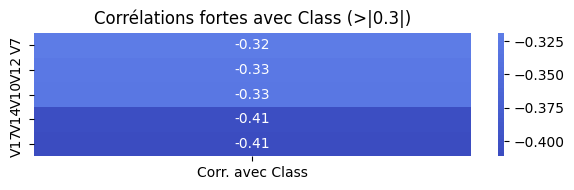


--- Évaluation et ajustement du seuil ---

=== Modèle : LogisticRegression ===
Meilleur seuil (F1): 0.074 avec F1=0.911
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     42628
           1       1.00      0.84      0.91        98

    accuracy                           1.00     42726
   macro avg       1.00      0.92      0.96     42726
weighted avg       1.00      1.00      1.00     42726

Matrice de confusion :
[[TN FP]
 [FN TP]]
[[42628     0]
 [   16    82]]



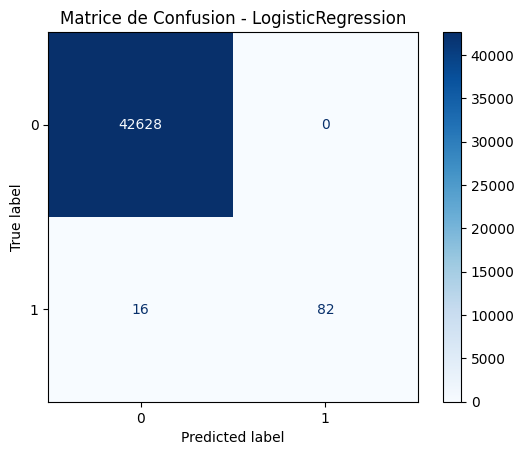

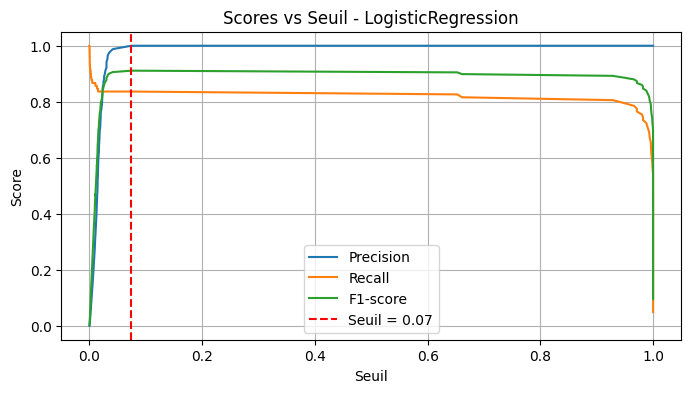

=== Modèle : RandomForest ===
Meilleur seuil (F1): 0.620 avec F1=0.923
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     42628
           1       1.00      0.86      0.92        98

    accuracy                           1.00     42726
   macro avg       1.00      0.93      0.96     42726
weighted avg       1.00      1.00      1.00     42726

Matrice de confusion :
[[TN FP]
 [FN TP]]
[[42628     0]
 [   14    84]]



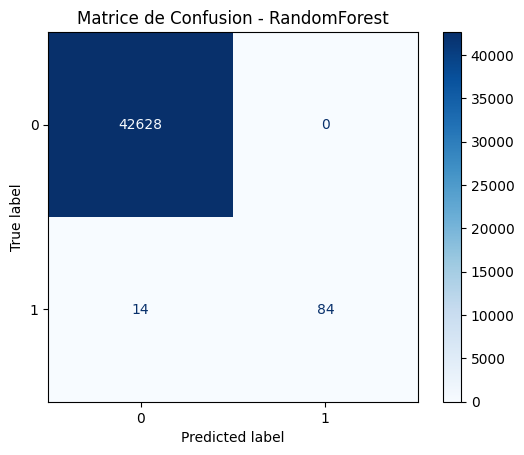

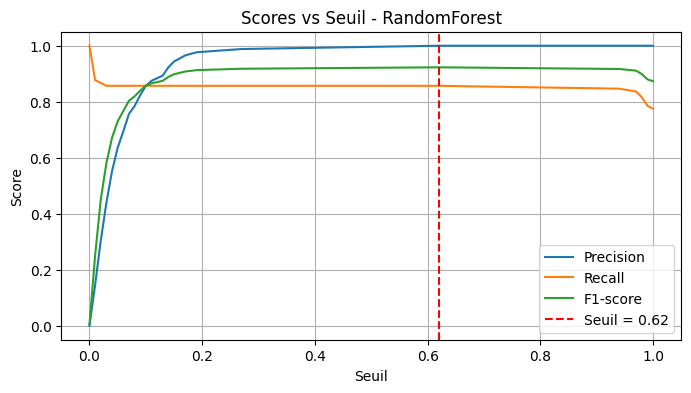

=== Modèle : XGBoost ===


/home/akkodis-nizar_el-maghroudi/Projet_MCT244/MCT244/rt/python/default/3.11.11/lib/python3.11/site-packages/xgboost/training.py:183: UserWarning:

[11:28:42] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.




Meilleur seuil (F1): 0.693 avec F1=0.900
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     42628
           1       0.99      0.83      0.90        98

    accuracy                           1.00     42726
   macro avg       0.99      0.91      0.95     42726
weighted avg       1.00      1.00      1.00     42726

Matrice de confusion :
[[TN FP]
 [FN TP]]
[[42627     1]
 [   17    81]]



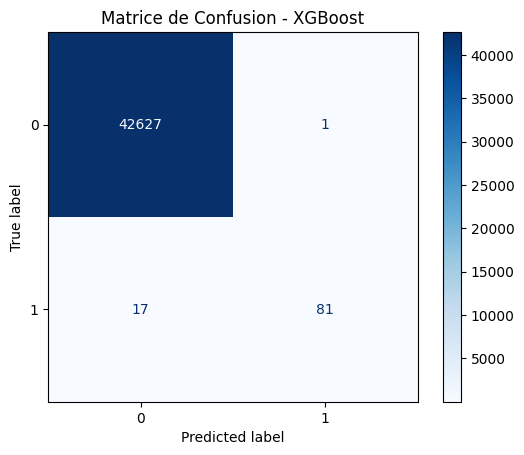

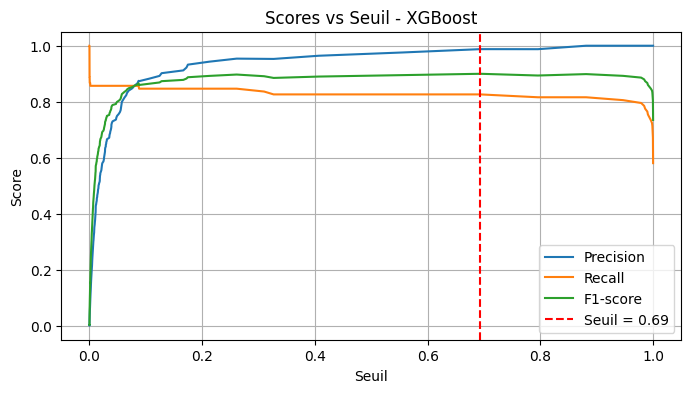

=== Modèle : LightGBM ===
[LightGBM] [Info] Number of positive: 394, number of negative: 170510
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001471 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 170904, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002305 -> initscore=-6.070198
[LightGBM] [Info] Start training from score -6.070198
Meilleur seuil (F1): 0.940 avec F1=0.905
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     42628
           1       1.00      0.83      0.91        98

    accuracy                           1.00     42726
   macro avg       1.00      0.91      0.95     42726
weighted avg       1.00      1.00      1.00     42726

Matrice de confusion :
[[TN FP]
 [FN TP]]
[[42628

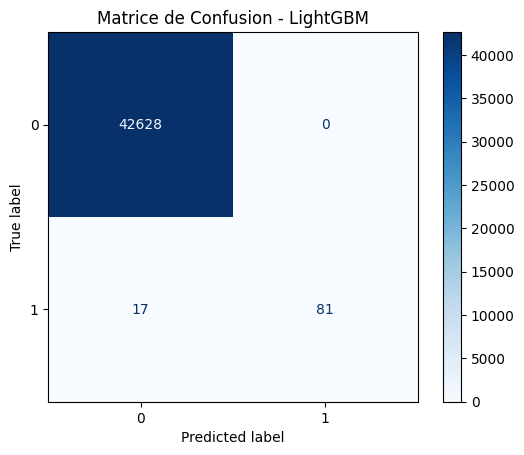

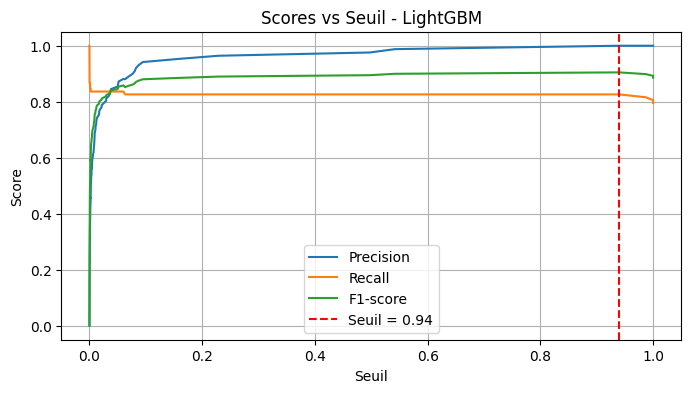

=== Modèle : GradientBoosting ===
Meilleur seuil (F1): 1.000 avec F1=0.902
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     42628
           1       0.97      0.85      0.90        98

    accuracy                           1.00     42726
   macro avg       0.98      0.92      0.95     42726
weighted avg       1.00      1.00      1.00     42726

Matrice de confusion :
[[TN FP]
 [FN TP]]
[[42625     3]
 [   15    83]]



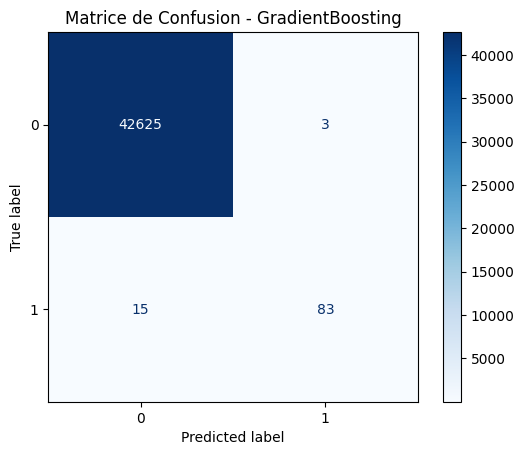

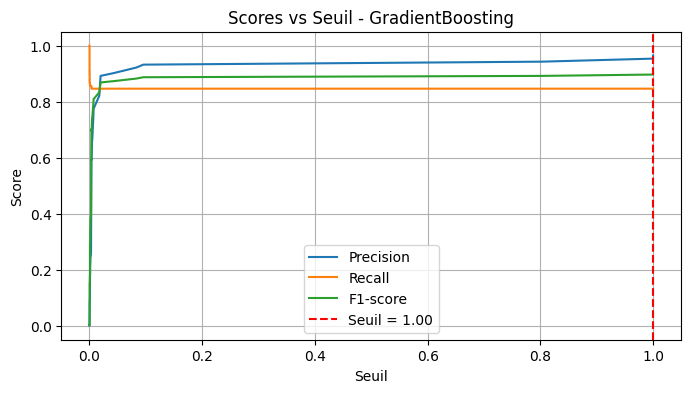

In [63]:
pipeline_corr_model_evaluation(df=dataset, target_col='Class', threshold=0.3)


In [63]:
pip install xgboost


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 253.9/253.9 MB 31.3 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 322.4/322.4 MB 51.8 MB/s eta 0:00:0000:0100:01

[notice] A new release of pip is available: 25.0.1 -> 25.1.1
[notice] To update, run: /home/akkodis-nizar_el-maghroudi/Projet_MCT244/MCT244/rt/python/default/3.11.11/bin/python -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [65]:
pip install --upgrade xgboost



[notice] A new release of pip is available: 25.0.1 -> 25.1.1
[notice] To update, run: /home/akkodis-nizar_el-maghroudi/Projet_MCT244/MCT244/rt/python/default/3.11.11/bin/python -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.
